# Coupon Collector's Problem - Python version
*by Roberto Esteban López Díaz*

The problem is as described in many literature and pages such as https://en.wikipedia.org/wiki/Coupon_collector's_problem
This program is writen to do simulation over to test the bounds from the expected value and variance calculated as shown in Mitzenmacher, Upfal's book chapter 2 and 3.

In [1]:
import numpy as np
import numpy.random as rdm
import matplotlib.pyplot as plt
import time
import math

In [2]:
def get_coupons(unique_items): # A function to do a simple run of the simulation of the problem
    rdm.seed(time.time_ns() % 2**32) ###New seed each execution
    
    unique_set = set(x for x in range(unique_items)) ### The set of unique coupons
    my_collection = set()
    tries = 0
    
    while my_collection != unique_set:
        my_collection.add(rdm.randint(0,high=unique_items))
        tries += 1
    return tries


class coupon_collect: # A more versatile form to call the simulation and run it as many times as required.
    def __init__(self, unique_items):
        self.unique_items = unique_items ## Saves the total different coupons the problem have.
        rdm.seed(time.time_ns() % 2**32) ###New seed each execution from the clock of the machine.
        self.tests = []
        
    def sample(self, samples): ## Call it to execute a number of samples, it returns a list with the result from each run.
        k = 0
        tests = []
        while k < samples: ### In this while executes all the samples of the experiments. Aka run it k times.
            my_collection = np.zeros(self.unique_items, dtype=np.uint8)
            my_coupons = 0
            tries = 0
            while my_coupons < self.unique_items:### Completing one run in this while. To collect all the coupons
                new_coupon = rdm.randint(0, high=self.unique_items)
                if my_collection[new_coupon] == 0: ## This is a new coupon to the collection
                    my_collection[new_coupon] = 1 
                    my_coupons += 1
                tries += 1
            self.tests.append(tries)
            k += 1
    
    def tests(self):
        return self.tests

For this experiment there are two paramerts, the maximum number of coupons for a collection to have and the number of samples per coupon collection to execute. The total of each experiment will be store in a list, this to calculate its mean and variance later(there could be better optimization in space, but for now is omited for little numbers).

In [3]:
coupons_4test = 200
samples = 500

tests = []
coupons_range = range(1, coupons_4test + 1)
start = 0
for coupons in coupons_range:
    if coupons % 10 == 1: start = time.time()
    collectionist = coupon_collect(coupons)
    collectionist.sample(samples)
    tests.append(collectionist.tests)
    if coupons % 10 == 0: print('Going in',coupons,'coupons in %.3f s' %(time.time()-start))

Going in 10 coupons in 0.193 s
Going in 20 coupons in 0.692 s
Going in 30 coupons in 1.260 s
Going in 40 coupons in 1.849 s
Going in 50 coupons in 2.660 s
Going in 60 coupons in 3.338 s
Going in 70 coupons in 4.204 s
Going in 80 coupons in 4.888 s
Going in 90 coupons in 5.690 s
Going in 100 coupons in 6.384 s
Going in 110 coupons in 7.756 s
Going in 120 coupons in 8.484 s
Going in 130 coupons in 8.772 s
Going in 140 coupons in 9.925 s
Going in 150 coupons in 10.812 s
Going in 160 coupons in 11.570 s
Going in 170 coupons in 12.228 s
Going in 180 coupons in 13.206 s
Going in 190 coupons in 13.879 s
Going in 200 coupons in 15.153 s


In [4]:
tests = np.array(tests) ## Making the results a numpy object will be easier to calculate its atributes later.
tests.shape

(200, 500)

Now the results of the experiments are ploted next, with both bounds to show the asymtotic behavior of the expected value and the standard deviation fo the Coupon Collector problem.

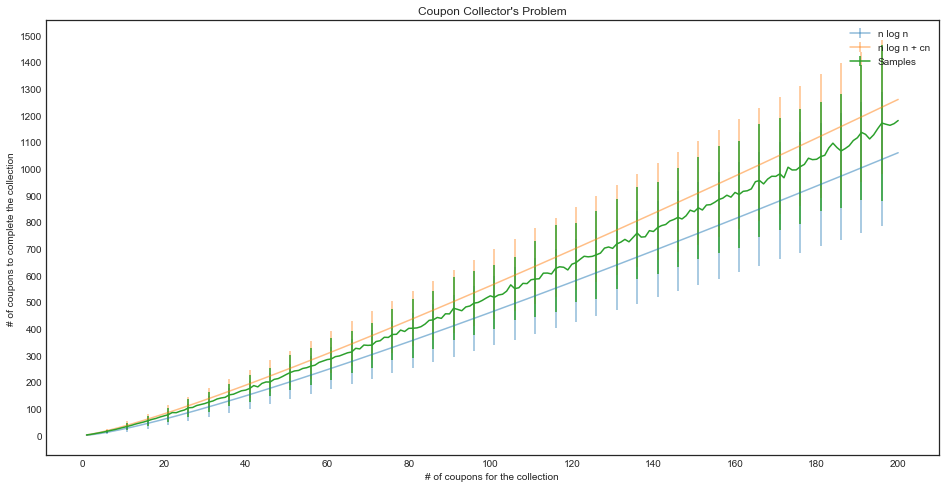

In [5]:
plt.style.use('seaborn-white')
fig, axs = plt.subplots(figsize=(16,8))
error_each = 5
plt.title('Coupon Collector\'s Problem',)
axs.errorbar(coupons_range, [j*math.log(j) for j in coupons_range], [(n*np.pi) / np.sqrt(6) for n in coupons_range],
             label='n log n', alpha = 0.5, errorevery=error_each)
axs.errorbar(coupons_range, [j*math.log(j) + j for j in coupons_range], [(n*np.pi) / np.sqrt(6) for n in coupons_range],
             label='n log n + n', alpha = 0.5, errorevery=error_each)
axs.errorbar(coupons_range, np.mean(tests,axis=1), np.sqrt(np.var(tests, axis=1)), label='Samples', errorevery=error_each)
axs.locator_params(nbins=20)
axs.set_xlabel('# of coupons for the collection')
axs.set_ylabel('# of coupons to complete the collection')
plt.legend()

Now to analyze further the behavior of the problem, we will make more experiments with more samples to compare the probability of $P(X \leq n \ln n + cn)$. This time just for a previous ticket collection sampled.

In [6]:
cs = np.arange(-5, 5 + 1, 0.2)
P_x = []
for coupons in coupons_range:
    actual_collection = tests[coupons - 1]
    probs = []
    for ci in cs:
        P = coupons*np.log(coupons) + ci*coupons
        P_for_ci = 0
        for result in actual_collection:
            if result <= P: P_for_ci += 1
        probs.append(P_for_ci / samples)
    P_x.append(probs)
P_x = np.array(P_x)

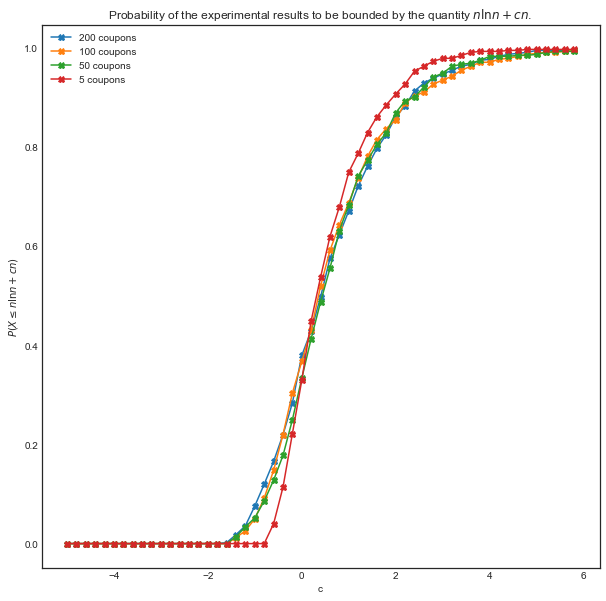

In [7]:
fig, axs = plt.subplots(figsize=(10,10))
plt.title("Probability of the experimental results to be bounded by the quantity $n \ln n + cn$.")
plt.plot(cs, P_x[199], marker='X', label='200 coupons')
plt.plot(cs, P_x[99], marker='X', label='100 coupons')
plt.plot(cs, P_x[49], marker='X', label='50 coupons')
plt.plot(cs, P_x[4], marker='X', label='5 coupons')
axs.set_xlabel("c")
axs.set_ylabel("$P(X \leq n \ln n + cn)$")
plt.legend()

The results from the graph make sense as in the previous results from the first one, which shows that the bound of $n\ln(n)$ is in most cases under the mean from the experiments. So one can expect that for values less than 0 for $c$ that makes this bound to decrease in value the probabilities decay to 0. 

Another test is to put a value $k$ into the expression to result $kn\ln(n) + cn$, which could be an interesting modification to the bound $O(\cdot)$. 
In the next graphs it reflects a bit more if the behavior given some number of coupons in heatmap representations of the probability given the values $c$ and $k$.

In [8]:
ks = np.arange(1, 5, 0.25, dtype=np.float16)
P_xx = []

for coupons in coupons_range:
    actual_collection = tests[coupons - 1]
    probs_k = []
    for k in ks:
        probs_c = []
        for ci in cs:
            P = k*coupons*np.log(coupons) + ci*coupons
            P_for_ci = 0
            for result in actual_collection:
                if result <= P: P_for_ci += 1
            probs_c.append(P_for_ci / samples)
        probs_k.append(probs_c)
    P_xx.append(probs_k)
P_xx = np.array(P_xx)
P_xx.shape

(200, 16, 55)

Text(0.5, 0, '$P(X \\leq k n \\ln(n) + cn)$')

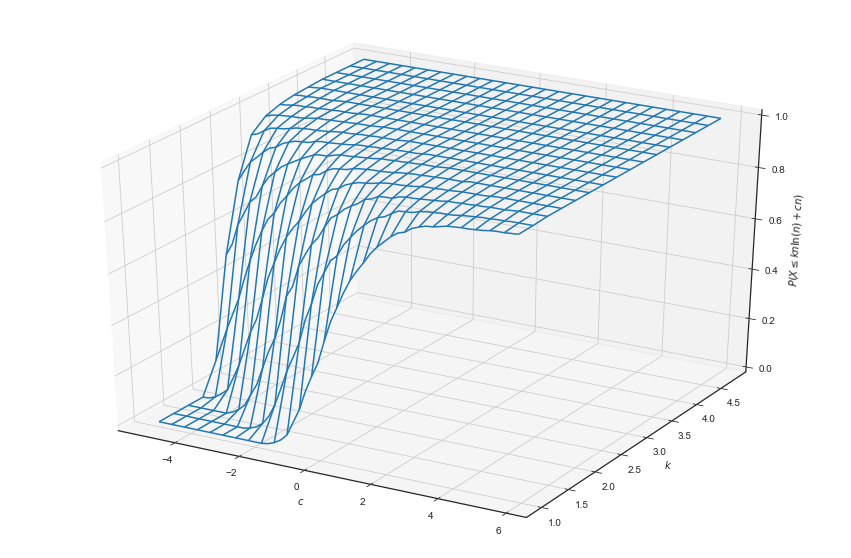

In [9]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(figsize=(15, 10))
ax = fig.gca(projection='3d')

C, K = np.meshgrid(cs, ks)
ax.plot_wireframe(C, K, P_xx[69])
ax.set_xlabel("$c$")
ax.set_ylabel("$k$")
ax.set_zlabel("$P(X \leq k n \ln(n) + cn)$")

In [30]:
import seaborn as sns
import imageio
def heato(coupons, image=True):
    fig, axs = plt.subplots(figsize=(12,10))
    heat = sns.heatmap(P_xx[coupons-1], vmin=0, vmax= 1, ax=axs, xticklabels=np.array(cs,dtype=np.float16), yticklabels=ks)
    axs.set(xlabel='c', ylabel='k', title="Probabilities of $P(X\leq kn\ln(n)+cn)$ for %d different coupons." %(coupons))
    #plt.show()
    if image:
        fig.canvas.draw()       # draw the canvas, cache the renderer
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        plt.clf()
        return image
    else:
        return heat

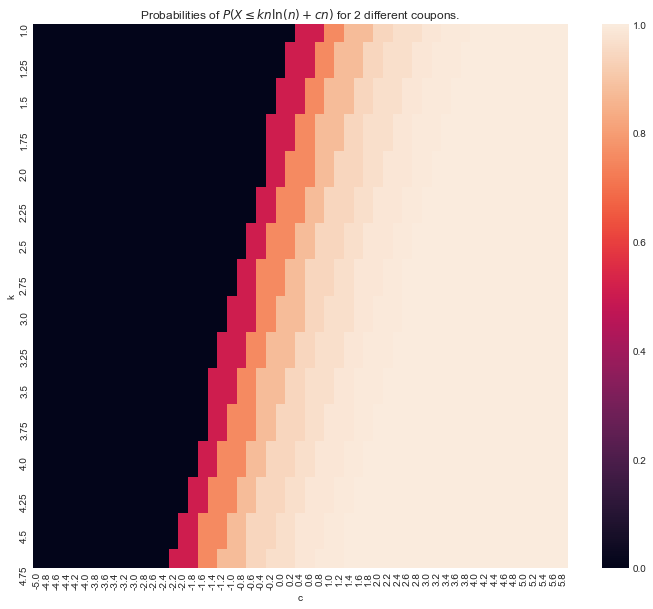

In [33]:
heato(2, image=False)

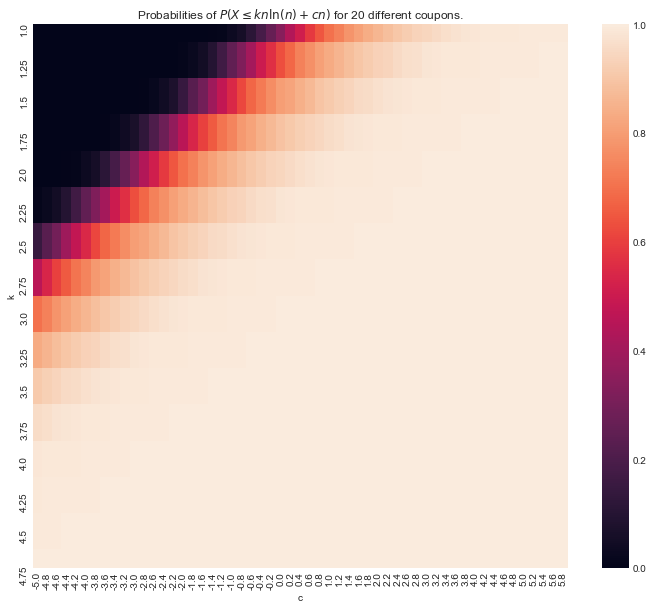

In [32]:
heato(20,image=False)

In [38]:
imageio.mimsave('./probs_c_and_k.gif', [heato(i) for i in coupons_range], fps=4)

U:\Users\Roberto\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

<Figure size 864x720 with 0 Axes>

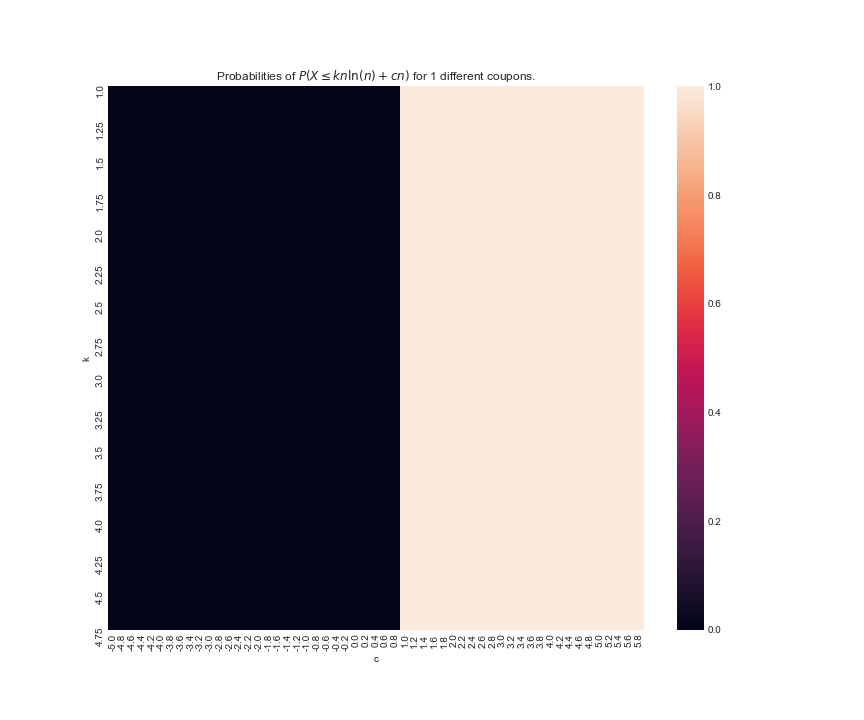

In [40]:
from IPython.display import Image
Image(filename='probs_c_and_k.gif')